In [1]:
import os
import pandas as pd
import geopandas as gpd
import json

#plotly uses mapbox for basemaps, so you'll need a free mapbox account and key to access.
#i've provided this one for NICAR2024
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
px.set_mapbox_access_token('pk.eyJ1IjoiYWthbmlrIiwiYSI6ImNsdGFrdHpxZjFqMmUycW1nc3FnMHA4a2MifQ.16KleiQqPPWyXGIeUPoxlw')


pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

/var/folders/2g/mqj0d6v95vbfcqgf7kpgrsrc0000gr/T/ipykernel_83041/2351469824.py:2: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


## Buffers
Let's create a 0.25-mile buffer around each of our schools. That way, we can use `sjoin` to search for things (liquor stores, superfund sites, parkes, crimes, etc) that are close by.

`buffer()` takes a "distance" parameter. The units that `buffer` will use are directly tied to the projection of your file. Use [https://epsg.io](https://epsg.io) to see which unit your shapes are using.

In [2]:
md_schools = gpd.read_file('../data/md-public-schools/EDGE_GEOCODE_PUBLICSCH_2223_Maryland.shp')
print('Original crs:',md_schools.crs)

#transforming to a crs that uses feet
md_schools.to_crs('EPSG:2248',inplace=True)
print('Reprojected crs:',md_schools.crs)

#1mile = 5280; .25mile = 1320
md_school_buffers = md_schools.copy()
md_school_buffers['buffer_geo'] = md_school_buffers.buffer(distance=5280)
md_school_buffers = md_school_buffers.set_geometry('buffer_geo')
md_school_buffers.drop('geometry',axis=1,inplace=True)

md_school_buffers.head()

Original crs: EPSG:4269
Reprojected crs: EPSG:2248


,NCESSCH,LEAID,NAME,OPSTFIPS,STREET,CITY,STATE,ZIP,STFIP,CNTY,NMCNTY,LOCALE,LAT,LON,CBSA,NMCBSA,CBSATYPE,CSA,NMCSA,NECTA,NMNECTA,CD,SLDL,SLDU,SCHOOLYEAR,buffer_geo
0,110008700213,1100087,Maya Angelou Academy at New Beginnings formerl...,11,8400 River Rd,Laurel,MD,20724,24,24003,Anne Arundel County,41,39.101153,-76.787327,12580,"Baltimore-Columbia-Towson, MD",1,548,"Washington-Baltimore-Arlington, DC-MD-VA-WV-PA",N,N,2403,24021,24021,2022-2023,"POLYGON ((1377967.672 522494.931, 1377942.248 ..."
1,240002701669,2400027,The Seed School of Maryland,24,200 Font Hill Avenue,Baltimore,MD,21223,24,24510,Baltimore city,11,39.284040,-76.664092,12580,"Baltimore-Columbia-Towson, MD",1,548,"Washington-Baltimore-Arlington, DC-MD-VA-WV-PA",N,N,2407,2444A,24044,2022-2023,"POLYGON ((1412695.223 589211.176, 1412669.798 ..."
2,240003000001,2400030,Allegany High,24,900 Seton Dr,Cumberland,MD,21502,24,24001,Allegany County,13,39.655804,-78.795466,19060,"Cumberland, MD-WV",1,N,N,N,N,2406,2401C,24001,2022-2023,"POLYGON ((812084.781 729424.565, 812059.356 72..."
3,240003000003,2400030,Beall Elementary,24,3 E College Ave,Frostburg,MD,21532,24,24001,Allegany County,23,39.654300,-78.931800,19060,"Cumberland, MD-WV",1,N,N,N,N,2406,2401B,24001,2022-2023,"POLYGON ((773692.731 729660.447, 773667.307 72..."
4,240003000005,2400030,Bel Air Elementary,24,14401 Barton Blvd,Cumberland,MD,21502,24,24001,Allegany County,41,39.578800,-78.853700,19060,"Cumberland, MD-WV",1,N,N,N,N,2406,2401A,24001,2022-2023,"POLYGON ((795121.172 701707.483, 795095.747 70..."


<Axes: >

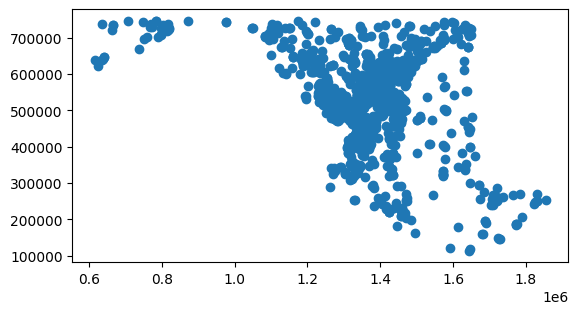

In [3]:
md_schools.plot()

<Axes: >

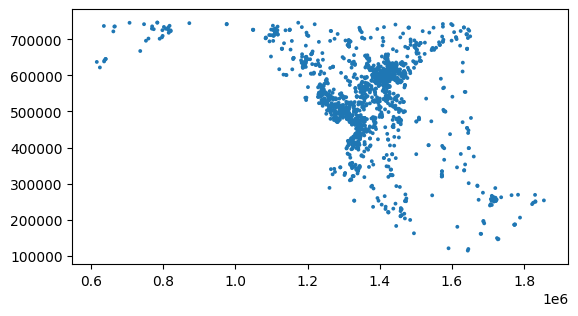

In [4]:
md_school_buffers.plot()

It's really hard to tell if that worked because of how crappy the detail `plot` function is. But never fear! We're going to use plotly to make things prettier.

Here's [a complete list of all of the parameters](https://plotly.github.io/plotly.py-docs/generated/plotly.express.choropleth_mapbox.html) that `px.choropleth_mapbox()` takes.

In [5]:
#Changing the projection so it works nicely with plotly
md_school_buffers = md_school_buffers.to_crs('EPSG:4326')

#Setting the index because plotly needs this
md_school_buffers.set_index('NCESSCH',inplace=True)

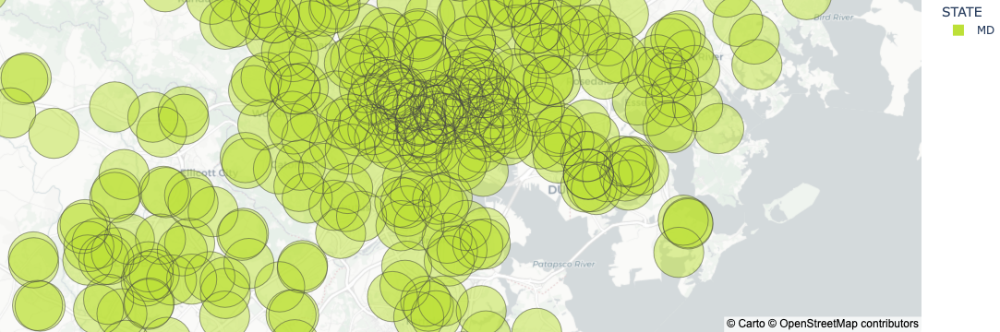

In [6]:
md_school_buffers = md_school_buffers.to_crs(epsg=4326)

fig = px.choropleth_mapbox(md_schools[['STATE','NCESSCH','NAME']], geojson=md_school_buffers, 
                           locations='NCESSCH',
                           color='STATE',
                           color_discrete_map={'MD':'#BDE038'},
                           hover_data=['NAME','NCESSCH'],
                           mapbox_style="carto-positron",
                           zoom=10, center = {"lat": 39.271123, "lon": -76.611230},
                           opacity=0.5,
                           
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## Clusters
My preferred way of doing clustering is creating hexbins. Plotly makes that really easy!

In [ ]:
md_schools = gpd.read_file('../data/md-public-schools/EDGE_GEOCODE_PUBLICSCH_2223_Maryland.shp')

fig = ff.create_hexbin_mapbox(
    data_frame=md_schools, lat="LAT", lon="LON",
    nx_hexagon=10, opacity=0.5, labels={"color": "Point Count"},
    min_count=1,
)
fig.show()

A larger `nx_hexagon` number will create smaller hexbins.

In [ ]:
hexbin_fig = ff.create_hexbin_mapbox(
    data_frame=md_schools, lat="LAT", lon="LON",
    nx_hexagon=30, opacity=0.5, labels={"color": "Point Count"},
    min_count=1,
)
hexbin_fig.show()

## Datawrapper and sharing
But sometimes, the easiest way to share mapping analysis with your team is exporting to a geojson and uploading into Datawrapper. I do this all the time because it allows non-technical reporters to explore the data on their own.

First let's export those hexbins. This might look at little complicatd but really it's just that the `hexbin_fig` has the geojson nested within it. So we just need to pull that out and save it as a geojson.

In [ ]:
hexbin_geojson = hexbin_fig['data'][0]['geojson']
hexbin_outfile = '../data/processed/md-school-hexbins.json'

with open(hexbin_outfile, 'w') as outfile:
    outfile.write(json.dumps(hexbin_geojson))

#let's also see how big this file is so we know what we need to do with it 
#in order to load into Datawrapper
file_stats = os.stat(hexbin_outfile)

print(file_stats)
print(f'File Size in Bytes is {file_stats.st_size}')
print(f'File Size in MegaBytes is {file_stats.st_size / (1024 * 1024)}')

Aces! That file is super small. However, let's try the same thing with our Baltimore neighborhoods.

In [ ]:
bmore_hoods = gpd.read_file('../data/bmore-neighborhoods/Neighborhood.shp')

#since this is loaded as a geopandas dataframe, we can export more easily
bmore_hood_outfile = '../data/processed/bmore-neighborhoods.geojson'
bmore_hoods.to_file(bmore_hood_outfile, driver='GeoJSON')

file_stats = os.stat(bmore_hood_outfile)

print(file_stats)
print(f'File Size in Bytes is {file_stats.st_size}')
print(f'File Size in MegaBytes is {file_stats.st_size / (1024 * 1024)}')

Yikes!!! 7MB is way too big for Datawrapper. DW requires 2MB or smaller. What can we do?! There are scripted ways of reducing geojson size, but I have always preferred using a more visual interface for this. I like to use the online tool mapshaper.